In [30]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
import torch
import torch.nn as nn
import torchvision
import torchvision.transforms as transforms
from torchvision import datasets
from PIL import Image

import os
from os import listdir
from os.path import isfile, join
import string

from sklearn.svm import SVC
from sklearn.model_selection import GridSearchCV

os.chdir('E:/College/Final Year Project/ufi')

In [13]:
train_data = datasets.ImageFolder('data/train', transform=transforms.ToTensor())

test_data = datasets.ImageFolder('data/test', transform=transforms.ToTensor())

In [14]:
train_data, test_data

(Dataset ImageFolder
     Number of datapoints: 4316
     Root Location: data/train
     Transforms (if any): ToTensor()
     Target Transforms (if any): None, Dataset ImageFolder
     Number of datapoints: 605
     Root Location: data/test
     Transforms (if any): ToTensor()
     Target Transforms (if any): None)

In [15]:
train_loader = torch.utils.data.DataLoader(dataset=train_data,
                                         batch_size=32)
test_loader = torch.utils.data.DataLoader(dataset=test_data,
                                         batch_size=32)

In [16]:
#sample batch check
data_iter = iter(train_loader)
X_, Y_ = data_iter.next()

X_.size(), Y_.size()

(torch.Size([32, 3, 128, 128]), torch.Size([32]))

In [17]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
use_cuda = True

In [18]:
os.environ['TORCH_MODEL_ZOO'] = 'E:\\College\\Final Year Project\\models'
model_pre = torchvision.models.resnet50(pretrained=True)

In [19]:
from collections import OrderedDict


classifier = nn.Sequential(OrderedDict([
                          ('fc1', nn.Linear(8192, 2048)),
                          ('relu1', nn.ReLU()),
                          ('dropout1', nn.Dropout(0.5)),
                          ('fc2', nn.Linear(2048, 1024)),
                          ('relu2', nn.ReLU()),
                          ('dropout2', nn.Dropout(0.5)),
                          ('output', nn.Linear(1024, 605))
                          ])) 
model_pre.avgpool = nn.AvgPool2d(kernel_size=3, stride=1, padding=0)
model_pre.fc = classifier

In [20]:
model_pre.to(device)

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=F

In [22]:
# load the model that got the best validation accuracy
model_pre.load_state_dict(torch.load('cnn_svm/model.pt'))

In [23]:
model_conv = nn.Sequential(*list(model_pre.children())[:-1])

In [24]:
X, Y = [], []
for (data, target) in train_loader:
        # move to GPU
        if use_cuda:
            data, target = data.cuda(), target.cuda()

        features = model_conv(data)
        features = features.view(-1, 8192)
        X.append((features).detach().cpu().numpy())
        Y.append((target).cpu().numpy())
        

In [25]:
np.asarray(X).shape, np.asarray(Y).shape

((135,), (135,))

In [26]:
x_train = np.asarray(X[0])
for arr in X[1:]:
    x_train = np.vstack((x_train, arr))

y_train = np.asarray(Y[0])
for arr in Y[1:]:
    y_train = np.hstack((y_train, arr))

In [27]:
x_train.shape, y_train.shape

((4316, 8192), (4316,))

In [16]:
clf = SVC(kernel = 'linear')
grid = {'C': [1, 2, 10, 100]}
abc = GridSearchCV(clf, grid)
abc.fit(x_train, y_train)

C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_split.py:1943: FutureWarning: You should specify a value for 'cv' instead of relying on the default value. The default value will change from 3 to 5 in version 0.22.
  warnings.warn(CV_WARNING, FutureWarning)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_split.py:626: Warning: The least populated class in y has only 1 members, which is too few. The minimum number of members in any class cannot be less than n_splits=3.
  % (min_groups, self.n_splits)), Warning)
C:\ProgramData\Anaconda3\lib\site-packages\sklearn\model_selection\_search.py:841: DeprecationWarning: The default of the `iid` parameter will change from True to False in version 0.22 and will be removed in 0.24. This will change numeric results when test-set sizes are unequal.
  DeprecationWarning)


GridSearchCV(cv='warn', error_score='raise-deprecating',
       estimator=SVC(C=1.0, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='auto_deprecated',
  kernel='linear', max_iter=-1, probability=False, random_state=None,
  shrinking=True, tol=0.001, verbose=False),
       fit_params=None, iid='warn', n_jobs=None,
       param_grid={'C': [1, 2, 10, 100]}, pre_dispatch='2*n_jobs',
       refit=True, return_train_score='warn', scoring=None, verbose=0)

In [17]:
abc.best_estimator_

SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='auto_deprecated',
  kernel='linear', max_iter=-1, probability=False, random_state=None,
  shrinking=True, tol=0.001, verbose=False)

In [32]:
clf = SVC(C=1, cache_size=200, class_weight=None, coef0=0.0,
  decision_function_shape='ovr', degree=3, gamma='auto_deprecated',
  kernel='linear', max_iter=-1, probability=False, random_state=None,
  shrinking=True, tol=0.001, verbose=False)

clf.fit(x_train, y_train)
clf.score(x_train, y_train)

1.0

In [33]:
X, Y = [], []
for (data, target) in test_loader:
        # move to GPU
        if use_cuda:
            data, target = data.cuda(), target.cuda()

        features = model_conv(data)
        features = features.view(-1, 8192)
        X.append((features).detach().cpu().numpy())
        Y.append((target).cpu().numpy())
        

In [34]:
np.asarray(X).shape, np.asarray(Y).shape

((19,), (19,))

In [35]:
x_test = np.asarray(X[0])
for arr in X[1:]:
    x_test = np.vstack((x_test, arr))

y_test = np.asarray(Y[0])
for arr in Y[1:]:
    y_test = np.hstack((y_test, arr))

In [36]:
x_test.shape, y_test.shape

((605, 8192), (605,))

In [37]:
clf.score(x_test, y_test)

0.6016528925619835

In [115]:
def predict(img_path):
    # load the image and return the predicted breed
    img = Image.open(img_path).convert('RGB')

    transform = transforms.ToTensor()
    img_tensor = transform(img).cuda()

    # reshaping to include batch size
    img_tensor = img_tensor.view(-1, img_tensor.shape[0], img_tensor.shape[1], img_tensor.shape[2])
    
    features = model_conv(img_tensor.cuda())
    features = features.view(-1, 8192)
    features = features.detach().cpu().numpy()
    
    class_idx = clf.predict(features)[0]
    
    return train_data.classes[class_idx]

In [116]:
class_names = os.listdir('data/test')

test_filenames = []
for class_name in class_names:
    test_filenames.append(os.path.join('data/test/'+ class_name + '/', os.listdir('data/test/'+ class_name)[0]))

In [117]:
X, Y = [], []
for (data, target) in test_loader:
        # move to GPU
        if use_cuda:
            data, target = data.cuda(), target.cuda()

        features = model_conv(data)
        features = features.view(-1, 8192)
        X.append((features).detach().cpu().numpy())
        Y.append((target).cpu().numpy())

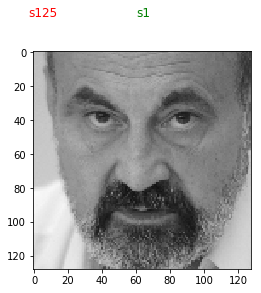

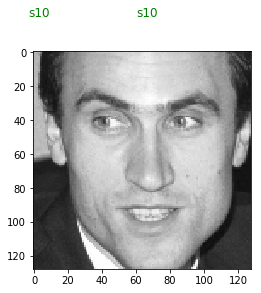

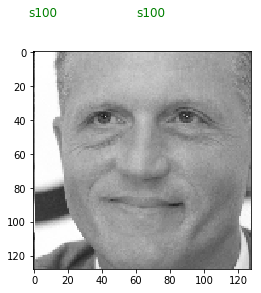

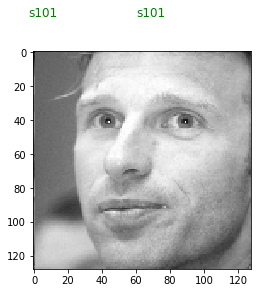

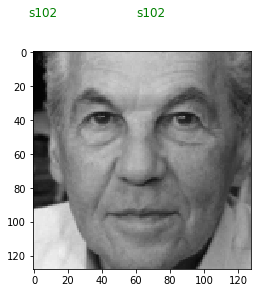

...

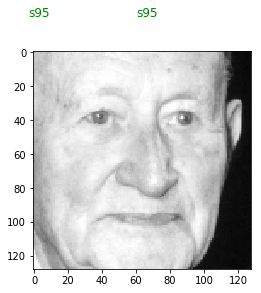

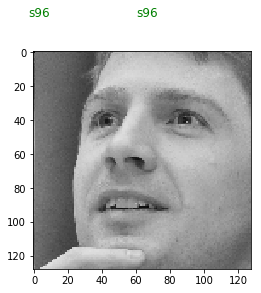

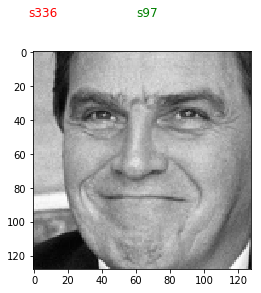

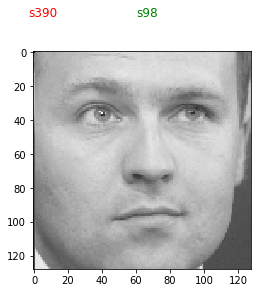

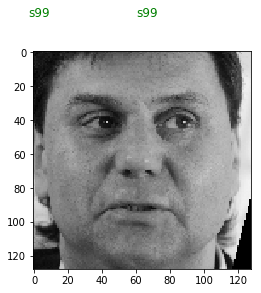

In [119]:
for label, path in zip(class_names, test_filenames):
    pred = predict(path)
    plt.imshow(Image.open(path), cmap=plt.cm.gray)
    if (pred == label):
        plt.gcf().text(0.25, 1, pred, fontsize=12, color='green')
        plt.gcf().text(0.5, 1, label, fontsize=12, color='green')
    else:
        plt.gcf().text(0.25, 1, pred, fontsize=12, color='red')
        plt.gcf().text(0.5, 1, label, fontsize=12, color='green')
    plt.show()